# OCR - From images to text

In this notebook, we're going to see how we can extract text from images using the ```pytesseract``` library. However, we're going to touch on a lot of different skills we've learned this semester - including drawing on ideas from Language Analytics, too!

In [6]:
# basic python tools
import re, os, sys
sys.path.append("..")

# OCR tools
import cv2
import pytesseract

# util functions
from utils.imutils import jimshow as show
from utils.imutils import jimshow_channel as show_channel

# data processing tools
import numpy as np 
import pandas as pd 

# readymade spellchecker
from autocorrect import Speller

def clean_string(string):
    """Removes punctuation to assist in OCR correction"""
    processed = string.replace("\n"," ")\
                     .replace("\n\n"," ")\
                     .replace("__"," ")\
                     .replace(" - "," ")\
                     .replace('-""' ," ")\
                     .replace("|", "")\
                     .replace("!", "")\
                     .replace("\s\s"," ")\
                     .lstrip()
    return " ".join(processed.split())

## OCR using ```Tesseract```

Tesseract/pytesseract is quite a rich library with lots of different functionality and small tweaks and tricks that can improve your OCR. Check out the documentation for more info:

**Pytesseract:** [Github](https://github.com/h/pytesseract) <br><br>
**Tesseract:** [Github](https://github.com/tesseract-ocr/tesseract); [Documentation](https://tesseract-ocr.github.io/)

In [35]:
# filepath = os.path.join("..", 
#                         "..", 
#                         "cds-visual",
#                         "data", 
#                         "img", 
#                         "jefferson.jpg") 

filepath = os.path.join("King_James_Bible-Isaiah_26.jpg")                       

The simplest way of using ```pytesseract``` is simply to call the ```.image_to_string()```. As the name suggests, this produces a single string with all of the text content found in the image:

In [36]:
text = pytesseract.image_to_string(filepath)
print(text)

                        

 
                      

     

          

  

           

           

      

Ivy ge poaousot SPP
NOY} : PoyL{ops 4.18 NOY} sUOTeU OTF
posvorour ysey NOt} ‘aquo'TyT QO uo
eu oy} posvosour yseq NOUL GT
‘ystiod 0} Arourour 110u} TT?
epeul pus “Wot} posoasop pue po
VISTA NOY} WEY VLOJoLOY} * OSM you
Treys Aug ‘posvooop 9U9 fayg + OAT]
jou Teys Aoy} ‘prop 900 Kay, ¥1
‘oureu AY} JO UOTFUSUL O[VUL
om [pM Apao ooyy Aq yg : 8M IOAO
uoTuTmMop prey savy sey} OPIseq

   

oy} Te oun

  

       

                   

      

       

        

              

              

 

 

goved Ulepso ILM Noy} “axoT |, ST
‘TIOY} MOAep [[VYs Soruous oUt}
Jo org oy ‘vod apdood 94} 4\l au
ayy LOZ poureyse oq pure ‘oes T[eYS
Koy yng :908 you [La soy}, ‘dn
poy st pueg Ay} waya ‘axoT IT
"CUo'T 04} Jo Aysofeur oy} ployed ou
TA pue ‘Aysnfun Teop oy [[LM ssou
4qs11dn jo purl oy}, Ul : SsousNoe
AYSIL Ure] JOU oY [ILM yo “poxor
oy} 0} poMmoys oq MMoavy JOT, OT
‘SSOUSNOOJY.SLL ULV] [[L

The library also has a method for returning the information as a dataframe which contains a detailed collection of information about its predictions:

In [40]:
df = pytesseract.image_to_data(filepath, 
                               output_type='data.frame')

In [41]:
df

,level,page_num,block_num,par_num,line_num,word_num,left,top,width,height,conf,text
0,1,1,0,0,0,0,0,0,4032,3024,-1,NaN
1,2,1,1,0,0,0,0,0,0,34,-1,NaN
2,3,1,1,1,0,0,0,0,0,34,-1,NaN
3,4,1,1,1,1,0,0,0,0,34,-1,NaN
4,5,1,1,1,1,1,0,0,0,34,95,
...,...,...,...,...,...,...,...,...,...,...,...,...
1385,5,1,83,1,1,3,828,2633,16,9,83,3
1386,2,1,84,0,0,0,449,2636,1620,24,-1,NaN
1387,3,1,84,1,0,0,449,2636,1620,24,-1,NaN
1388,4,1,84,1,1,0,449,2636,1620,24,-1,NaN


## Preprocess with Open-CV

Note that Tesseract on Github give a bunch of tips for how best to preprocess images to improve performance. 

You should have the skills to actually do all of these things using OpenCV: https://github.com/tesseract-ocr/tessdoc/blob/main/ImproveQuality.md#rescaling

In [43]:
image = cv2.imread(filepath)

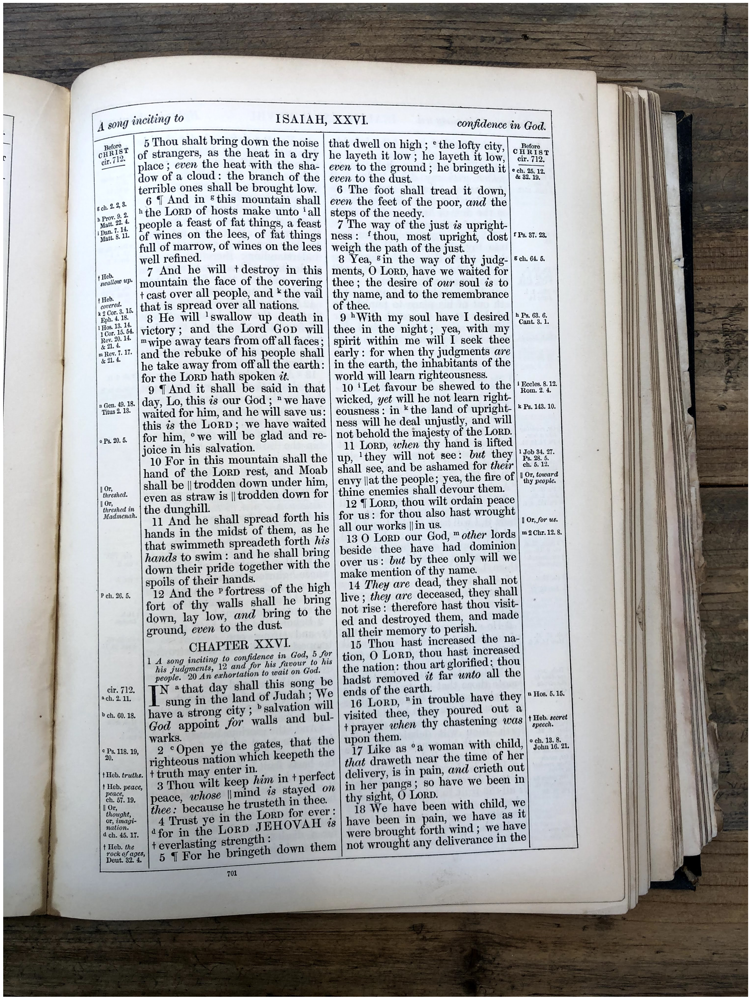

In [44]:
show(image)

__Crop__

The first thing we want to do is to crop this around the center of the image to keep only the main text.

In [85]:
from scipy import ndimage



(cX, cY) = (image.shape[1]//2, image.shape[0]//2)



cropped = image[cY-1490:cY+1390, cX-990:cX+600]

rotate_matrix = cv2.getRotationMatrix2D(center=center, angle=90, scale=1) 



# Opencv can locate text on an page and make a box around it
# A way to automaize the cropping process

TypeError: Can't parse 'center'. Expected sequence length 2, got 2880

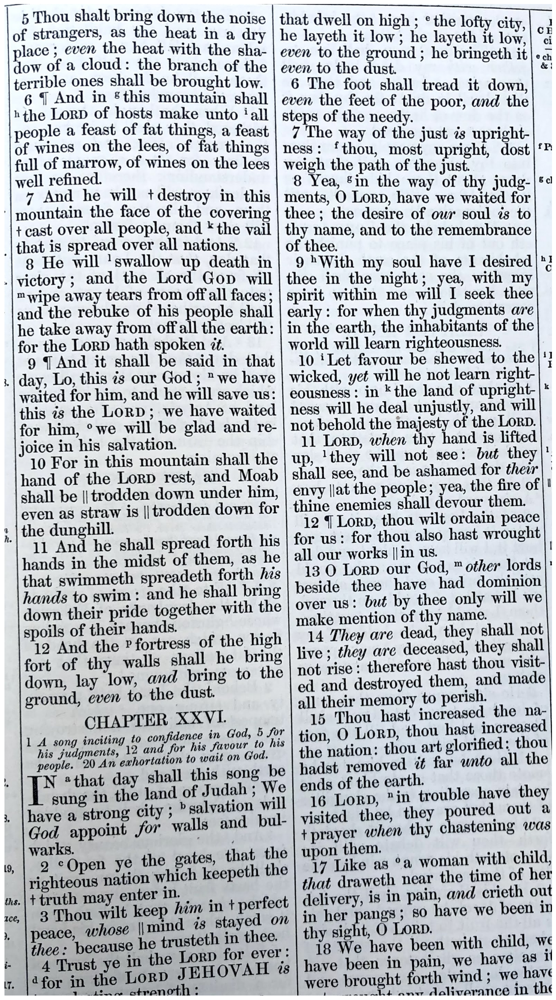

In [80]:
show(cropped)

__Greyscale__

Next, we greyscale the image to attempt to remove extra noise.

In [48]:
grey = cv2.cvtColor(cropped, cv2.COLOR_BGR2GRAY)

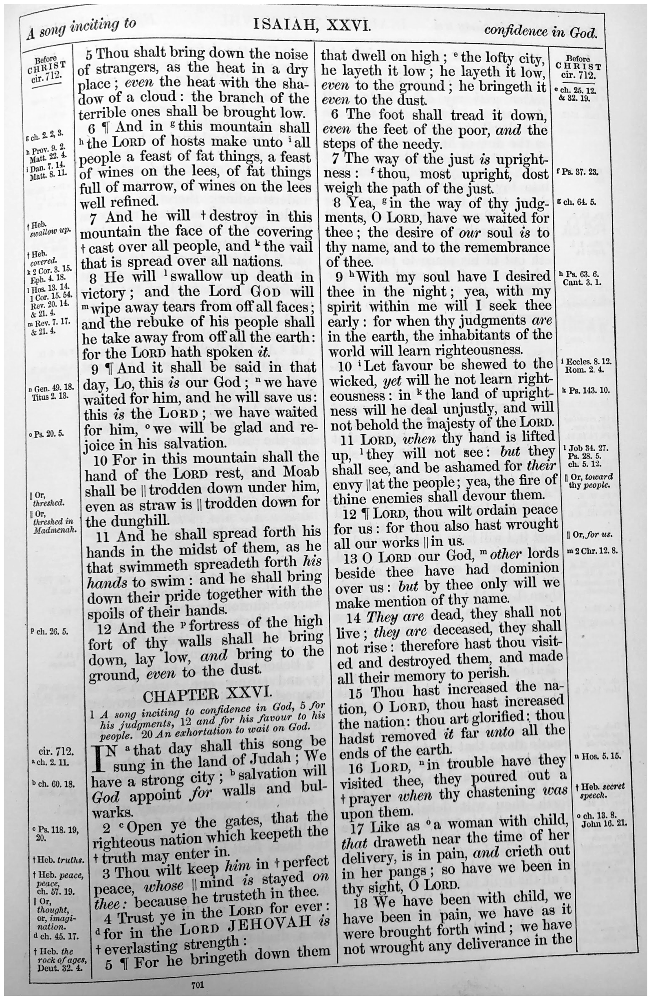

In [49]:
show_channel(grey)

__OCR again__

Let's see how these simple steps improve performance of the OCR model.

In [50]:
text = pytesseract.image_to_string(grey)

In [51]:
print(text)

 
  
      

ISAIAH, XXVI

ies 5 Thou shalt bring down th i
otitis? of strangers, as the heat it. ih ‘des
ont = | place; even the heat with the sha-
dow of a cloud: the branch of the
terrible ones shall be brought low.
cans 6 7 And in *this mountain shall
prov. 9: hthe Lorp of hosts make unto ‘all
“Mate nt people a feast of fat things, a feast
ipa 1L |of wines on the lees, of fat things
full of marrow, of wines on the lees
well ae
. 7 And he will tdestroy in thi
1 atiow UP mountain the face of heveovarine
ae +cast over all people, and * the vail
verel, ., that is spread over all nations.
ia oa 8 He will ‘swallow up death in

1Cor, 15, victory; and the Lord Gop will
re) |mwipe away tears from off all faces ;
ate" land the rebuke of his people shall
he take away from off all the earth:
for the LorD hath spoken 7.

9 § And it shall be said in that
a Gen. 49.18. | day, Lo, this 7s our God ; " we have
Tius2 18. | Voited for him, and he will save us:
this 7s the LorD; we have waited
spso.s. 

__Thresholding__

Way back when we worked more with OpenCV, we learned that we could also *binarize* images using thresholding to make everything black or white (like when we created *masks*).

In [26]:
# threshold
(T, thres) = cv2.threshold(grey, 110, 255, cv2.THRESH_BINARY) # ad _INV to the THRESH_BINARY to invert the color 

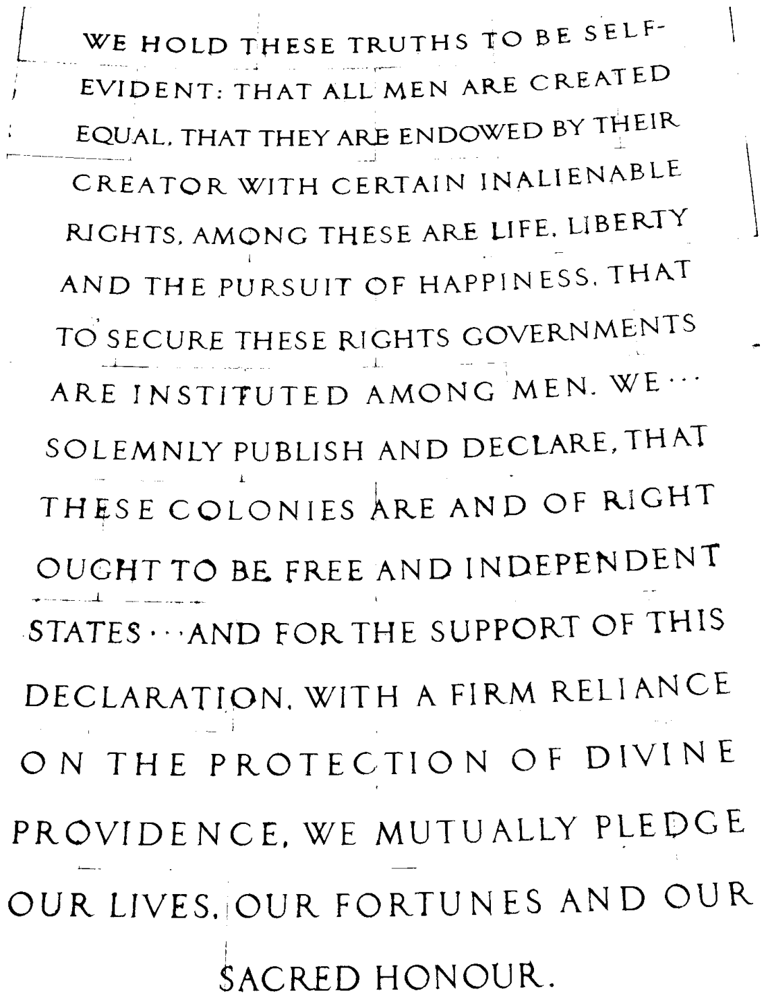

In [27]:
show_channel(thres)

In [28]:
text = pytesseract.image_to_string(thres)

In [29]:
print(text)

!

__ WE HOLD THESE TRUTHS TO BE SELF
EVIDENT: THAT ALL MEN ARE CREATED
- EQUAL. THAT THEY ARE ENDOWED BY THEIR
CREATOR WITH CERTAIN INALIENABLE |
RIGHTS, AMONG THESE ARE LIFE. LIBERTY
AND THE PURSUIT OF HAPPINESS. THAT
TO SECURE THESE RI IGHTS GOVERNMENT
ARE INSTIFUTED AMONG MEN. WE-""
SOLEMNLY PUBLISH AND DECLARE THAT
THESE COLONIES ARE AND OF RIGHT
OUGHT TO BE FREE AND INDEPENDENT
STATES AND FOR THE SUPPORT OF THIS
DECLARATION. WITH A FIRM RELIANCE
ON THE PROTECTION O F DIVINE
PROVIDENCE, WE MUTUALLY PLEDGE
OUR LIVES. OUR FORTUNES AND OUR

SACRED HONOUR.



## Quick and cheap spell checking

One of the main issues we seem to see is single-character errors which give misspelled words. So, let's see how far we can get by doing some simple spell checking and correction with the ```autocorrect``` library:

__Initialize speller__

In [30]:
spell = Speller(only_replacements=True)

In [31]:
cleaned = clean_string(text)

In [32]:
spell(cleaned.lower())

'we hold these truths to be self evident: that all men are created equal. that they are endowed by their creator with certain inalienable rights, among these are life. liberty and the pursuit of happiness. that to secure these ri ights government are instituted among men. we solemnly publish and declare that these colonies are and of right ought to be free and independent states and for the support of this declaration. with a firm reliance on the protection o f divine providence, we mutually pledge our lives. our fortunes and our sacred honour.'

## Tasks

__Spell checking with generative LLMs__
- Head over to HuggingChat and check out some of the newest LLMs perform on this task. Test all of the available models and ask the following questions

__Some test images__

- I've attached some links to culturally significant images below. How well does the OCR pipeline work on these images? What do you need to do to get it to work? What does this suggest about the challenges or limitations of OCR?
    - [Image 1](https://www.techsmith.com/blog/wp-content/uploads/2021/09/Make-a-meme-butterfly.png)
    - [Image 2](https://datasciencedojo.com/wp-content/uploads/52.jpg)
    - [Image 3](https://datasciencedojo.com/wp-content/uploads/36.png)
    - [Image 4 (an actually serious example)](https://upload.wikimedia.org/wikipedia/commons/7/7e/King_James_Bible-Isaiah_26.jpg)
    - [Image 5](https://imgs.xkcd.com/comics/git.png)